# 0. Loading Data

In [ ]:
!wget https://raw.githubusercontent.com/KubaKonieczny/inteligent-system-design/main/men-ihf-2021.csv

--2023-05-12 14:43:03--  https://raw.githubusercontent.com/KubaKonieczny/inteligent-system-design/main/men-ihf-2021.csv
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 350830 (343K) [text/plain]
Saving to: ‘men-ihf-2021.csv’

men-ihf-2021.csv    100%[===================>] 342.61K  --.-KB/s    in 0.02s   

2023-05-12 14:43:04 (18.4 MB/s) - ‘men-ihf-2021.csv’ saved [350830/350830]



In [ ]:
import pandas as pd

In [ ]:
df = pd.read_csv('/content/men-ihf-2021.csv', sep='\t', decimal=',') 

In [ ]:
df.head()

,Phase,Match No.,Match,Team,No.,Name,7mGoals,7mMissed,6mGoals,6mMissed,...,YC,RC,BC,2Min,AS,ST,BS,Time,scoring,prod100
0,Group Phase,1.0,EGY-CHI,EGY,5.0,OMAR Yahia,0.0,0.0,2.0,0.0,...,0.0,0.0,0.0,2.0,4.0,1.0,0.0,47.583333,1.75,3.677758
1,Group Phase,1.0,EGY-CHI,EGY,11.0,MOAMEN Ahmed,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,24.033333,-0.40,-1.664355
2,Group Phase,1.0,EGY-CHI,EGY,15.0,HESHAM Ahmed,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,20.550000,-2.25,-10.948905
3,Group Phase,1.0,EGY-CHI,EGY,24.0,ELMASRY Ibrahim,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,1.0,0.0,2.0,0.0,29.800000,2.80,9.395973
4,Group Phase,1.0,EGY-CHI,EGY,25.0,NAWAR Wisam,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,11.250000,0.00,0.000000


In [ ]:
df.describe()

,Match No.,No.,7mGoals,7mMissed,6mGoals,6mMissed,WingGoals,WingMissed,BTGoals,BTMissed,...,YC,RC,BC,2Min,AS,ST,BS,Time,scoring,prod100
count,3071.000000,3071.000000,3071.000000,3071.000000,3071.000000,3071.000000,3071.000000,3071.000000,3071.000000,3071.000000,...,3071.000000,3071.000000,3071.000000,3071.000000,3071.000000,3071.000000,3071.000000,3071.000000,3071.000000,2814.000000
mean,53.127320,28.550635,0.175187,0.054054,0.425594,0.176490,0.249430,0.152719,0.265386,0.085314,...,0.046890,0.006187,0.000651,0.258222,0.761316,0.228916,0.121459,26.428742,1.241534,NaN
std,31.938638,25.441546,0.698008,0.244168,0.960922,0.502872,0.749579,0.484070,0.674020,0.320651,...,0.211438,0.078426,0.025516,0.544511,1.321341,0.544463,0.440497,17.245680,2.663054,NaN
min,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-6.950000,-inf
25%,25.000000,11.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,12.666667,0.000000,-0.405611
50%,51.000000,21.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,26.900000,0.200000,1.967215
75%,81.000000,33.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,39.333333,2.350000,8.887669
max,108.000000,99.000000,7.000000,3.000000,8.000000,5.000000,7.000000,4.000000,6.000000,3.000000,...,1.000000,1.000000,1.000000,3.000000,10.000000,5.000000,6.000000,79.333333,19.550000,inf


In [ ]:
df.columns

Index(['Phase', 'Match No.', 'Match', 'Team', 'No.', 'Name', '7mGoals',
       '7mMissed', '6mGoals', '6mMissed', 'WingGoals', 'WingMissed', 'BTGoals',
       'BTMissed', 'FBGoals', 'FBMissed', 'EGGoals', 'EGMissed', '9mGoals',
       '9mMissed', 'TF', 'YC', 'RC', 'BC', '2Min', 'AS', 'ST', 'BS', 'Time',
       'scoring', 'prod100'],
      dtype='object')

# 1 Data Analysis

In [ ]:
%%capture
! pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip
from pandas_profiling import ProfileReport

In [ ]:
profile_d1 = ProfileReport(df, title="Players", html={'style':{'full_width': True}})
profile_d1.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

As we can see most of the alerts are connected to some variables being imbalance and having a lot of zeros. However, it was as expected because some players sit on the bench for the whole match and those who are playing are assigned to their positions so the winger will not score from the 9th meter and any other player will not score from the wing.

Now we have to check the type of our columns.

In [ ]:
df.dtypes

Phase          object
Match No.     float64
Match          object
Team           object
No.           float64
Name           object
7mGoals       float64
7mMissed      float64
6mGoals       float64
6mMissed      float64
WingGoals     float64
WingMissed    float64
BTGoals       float64
BTMissed      float64
FBGoals       float64
FBMissed      float64
EGGoals       float64
EGMissed      float64
9mGoals       float64
9mMissed      float64
TF            float64
YC            float64
RC            float64
BC            float64
2Min          float64
AS            float64
ST            float64
BS            float64
Time          float64
scoring       float64
prod100       float64
dtype: object

# 2 Clustering for players

In this section on discovering patterns among the players in Handball Man
World 2021 DataSet. In order to obtain groups of players with similar characteristics we will apply K-Means algorithm. 

In [ ]:
players_df = df

## 2.1 Null values

We have to check if there are any nulls.

In [ ]:
players_df[players_df.isnull().any(axis = 1)]

,Phase,Match No.,Match,Team,No.,Name,7mGoals,7mMissed,6mGoals,6mMissed,...,YC,RC,BC,2Min,AS,ST,BS,Time,scoring,prod100
28,Group Phase,1.0,EGY-CHI,CHI,23.0,CALLEJA Benjamin,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN
41,Group Phase,2.0,SWE-MKD,SWE,22.0,PELLAS Lucas,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN
45,Group Phase,2.0,SWE-MKD,SWE,28.0,EDVARDSSON Jonathan,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN
87,Group Phase,3.0,ALG-MAR,MAR,21.0,FOUGANI Nacym Hamed,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN
92,Group Phase,3.0,ALG-MAR,MAR,93.0,LAKBI Ryad,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3041,Main Round,108.0,DEN-SWE,DEN,7.0,JAKOBSEN Emil M.,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN
3057,Main Round,108.0,DEN-SWE,SWE,8.0,JONSSON Alfred,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN
3067,Main Round,108.0,DEN-SWE,SWE,28.0,EDVARDSSON Jonathan,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN
3070,Main Round,108.0,DEN-SWE,SWE,66.0,LINDSKOG Anton,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN


As you can see, there are some nulls in prod100 column. As this feature describes the player's productivity per 100 minutes, we will try to calculate it by ourself. 

After analysis we found out, that prod100 is equal null if and only if value in column 'Time' is equal 0. If player wasn't playing during this championship, she won't have any productivity score, thus we can set it to 0;

In [ ]:
players_df[[(players_df["prod100"].isnull()) & (players_df["Time"] == 0), "prod100"]] = 0

In [ ]:
players_df[players_df.isnull().any(axis = 1)]

,Phase,Match No.,Match,Team,No.,Name,7mGoals,7mMissed,6mGoals,6mMissed,...,YC,RC,BC,2Min,AS,ST,BS,Time,scoring,prod100
3071,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0


We got rid of all nulls.

## 2.2 Feature Selection/ Feature Engenering 


We will remove following features:
- 'Match No.', 'Match' and 'Phase' -> they are connected to match, what is irrelevant, because we will group our data by the player's name
- 'Team', 'No.' -> it is data connected to teams
- 'scoring', 'prod100' -> as it is hard to say how those values were calculated. We man use it later in as coperason for conclusions.


In [ ]:
features_to_drop = ['Match No.', 'Match', 'Team', 'No.', 'Phase', 'scoring', 'prod100']

In [ ]:
players_df = players_df.drop(columns = features_to_drop)

In [ ]:
time = df.groupby('Name').sum()

<ipython-input-16-cb3cf3601a07>:1: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  time = df.groupby('Name').sum()


In [ ]:
max(time[time['Time'] < 15].count())

37

In [ ]:
players_df = players_df.groupby('Name').mean()

We decided to remove all players who in total played less than 15 minutes during the championship, because such short plays aren't reliable, they only created noise.

In [ ]:
players_df = players_df[time['Time'] > 15]

We decided to create a new feature for each goal type, and substitute it for missed goals columns. The new feature will present the effectiveness of each player and will be calculated in following manner: Goals/(Goals + Missed) * Goals.

In [ ]:
players_df['7mEffect'] =  players_df['7mGoals'] * (players_df['7mGoals'].div(players_df['7mGoals'] + players_df['7mMissed']))
players_df['6mEffect'] =  players_df['6mGoals'] * (players_df['6mGoals'].div(players_df['6mGoals'] + players_df['6mMissed']))
players_df['WingEffect'] = players_df['WingGoals'] * (players_df['WingGoals'].div(players_df['WingGoals'] + players_df['WingMissed']))
players_df['BTEffect'] = players_df['BTGoals'] * (players_df['BTGoals'].div(players_df['BTGoals'] + players_df['BTMissed']))
players_df['FBEffect'] = players_df['FBGoals'] * (players_df['FBGoals'].div(players_df['FBGoals'] + players_df['FBMissed']))
players_df['EGEffect'] = players_df['EGGoals'] * (players_df['EGGoals'].div(players_df['EGGoals'] + players_df['EGMissed']))
players_df['9mEffect'] = players_df['EGGoals'] * (players_df['9mGoals'].div(players_df['9mGoals'] + players_df['9mMissed']))

In [ ]:
players_df['7mEffect'].fillna(0, inplace = True)
players_df['6mEffect'].fillna(0, inplace = True)
players_df['WingEffect'].fillna(0, inplace = True)
players_df['BTEffect'].fillna(0, inplace = True)
players_df['FBEffect'].fillna(0, inplace = True)
players_df['EGEffect'].fillna(0, inplace = True)
players_df['9mEffect'].fillna(0, inplace = True)

At first we decided to delete only 'Missed' columns, but as leaving 'Goals' features doesn't change anything in silthouette score, we decided to delete these features as well.

In [ ]:
features_to_drop = ['7mMissed', '7mGoals', '6mMissed', '6mGoals', 'WingMissed', 'WingGoals', 'BTMissed', 'BTGoals', 'FBMissed', 'FBGoals', 'EGMissed', 'EGGoals', '9mMissed', '9mGoals']

In [ ]:
# features_to_drop = ['7mMissed', '6mMissed', 'WingMissed', 'BTMissed', 'FBMissed', 'EGMissed', '9mMissed']

In [ ]:
players_df = players_df.drop(columns = features_to_drop)

What is more, we will remove YC column (because yellow cards are practically meaningless) and sum RC and BC columns, as red and blue cards have very similar meaning when it comes to game itself.

In [ ]:
players_df['RC_BC'] = players_df.apply(lambda x: x['RC'] + x['BC'], axis=1)

In [ ]:
players_df = players_df.drop(columns = ['YC', 'RC', 'BC'])

In [ ]:
players_df[ players_df['RC_BC'] !=0].count()

TF            19
2Min          19
AS            19
ST            19
BS            19
Time          19
7mEffect      19
6mEffect      19
WingEffect    19
BTEffect      19
FBEffect      19
EGEffect      19
9mEffect      19
RC_BC         19
dtype: int64

After analysis we found out, there was only 21 red and blue cards in total, what later on created outliers. That is why we also decided to remove 'RC_BC' column.

In [ ]:
players_df = players_df.drop(columns = ['RC_BC'])

In [ ]:
players_df.sample(10)

,TF,2Min,AS,ST,BS,Time,7mEffect,6mEffect,WingEffect,BTEffect,FBEffect,EGEffect,9mEffect
Name,,,,,,,,,,,,,
RODRIGUES Gustavo,0.800000,0.400000,1.600000,0.400000,0.200000,38.056667,0.0000,1.028571,0.0,0.714286,0.4,0.2,0.1
LINDSKOG Anton,0.333333,1.000000,0.000000,0.333333,0.000000,15.788889,0.0000,0.666667,0.0,0.000000,0.0,0.0,0.0
ILLESCA Benjamin,1.000000,0.000000,0.500000,0.000000,0.000000,8.908333,0.0000,0.000000,0.0,0.000000,0.5,0.0,0.0
MAAREF Yousef,1.000000,0.200000,1.600000,0.800000,0.400000,38.820000,0.0000,0.360000,0.0,0.640000,0.6,0.0,0.0
MAHFOODH Komail,1.200000,0.200000,1.400000,0.000000,0.200000,20.830000,0.0000,0.100000,0.0,0.400000,0.0,0.0,0.0
MAGNUSSON Omar Ingi,0.750000,0.250000,1.250000,0.250000,0.000000,25.841667,0.5625,0.000000,0.0,0.000000,0.0,0.0,0.0
DARJ Max,0.555556,1.222222,0.666667,0.333333,0.222222,46.135185,0.0000,0.793651,0.0,0.000000,0.5,0.0,0.0
BEN GHALI Ghazi,0.000000,1.000000,1.000000,0.000000,0.000000,33.916667,0.0000,4.000000,0.0,0.000000,0.0,0.0,0.0
FALABRINO MEDINA Diego,0.500000,0.000000,0.500000,0.000000,0.000000,15.991667,0.0000,0.000000,0.0,0.000000,0.0,0.0,0.0


We are dividing columns 'TF', '2Min', 'AS', 'ST' and 'BS' by 'Time' column (expressed in hours instead of minutes). Then, we delete the 'Time' column.

In [ ]:
players_df['Time'] = players_df['Time'] / 60

In [ ]:
players_df['TF'] = players_df['TF'].div(players_df['Time'])
players_df['2Min'] = players_df['2Min'].div(players_df['Time'])
players_df['AS'] = players_df['AS'].div(players_df['Time'])
players_df['ST'] = players_df['ST'].div(players_df['Time'])
players_df['BS'] = players_df['BS'].div(players_df['Time'])


In [ ]:
players_df.sample(10)

,TF,2Min,AS,ST,BS,Time,7mEffect,6mEffect,WingEffect,BTEffect,FBEffect,EGEffect,9mEffect
Name,,,,,,,,,,,,,
MAHFOODH Komail,3.456553,0.576092,4.032645,0.000000,0.576092,0.347167,0.000000,0.100000,0.000000,0.400000,0.000000,0.000000,0.0
ABIDI Mohamed,0.000000,0.000000,0.000000,0.000000,0.000000,0.407731,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0
RUBBO RODRIGUEZ Federico,2.678571,0.446429,0.000000,0.446429,0.000000,0.560000,0.000000,0.250000,0.050000,0.000000,0.333333,0.000000,0.0
PETERSSON Alexander,2.439438,0.609859,0.609859,1.829578,0.000000,0.409931,0.000000,0.000000,0.000000,0.125000,0.500000,0.000000,0.0
FRADE Luis,0.000000,0.000000,0.000000,0.000000,5.750799,0.695556,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0
ACQUEVILLO Jean Jacques,0.682270,1.364541,2.729082,0.341135,0.341135,0.488565,0.000000,0.300000,0.000000,0.222222,0.166667,0.000000,0.0
KIANGEBENI KAWOLA Johan,0.245131,0.245131,0.245131,0.245131,0.000000,0.679907,2.245614,0.000000,0.375000,0.000000,0.500000,0.166667,0.0
HANUSZ Egon,3.377744,0.000000,4.053293,0.675549,0.000000,0.493426,0.000000,0.000000,0.000000,0.333333,0.333333,0.000000,0.0
FOUGANI Nacym Hamed,0.468750,0.468750,0.937500,0.468750,0.000000,0.355556,0.000000,0.166667,0.187500,0.083333,0.333333,0.000000,0.0


In [ ]:
players_df = players_df.drop(columns = ['Time'])

In [ ]:
players_df.fillna(0, inplace = True)

Now we will group by players' names.

In [ ]:
players_df.max()

TF            10.946408
2Min           9.052808
AS             9.262436
ST             3.583873
BS             5.750799
7mEffect       3.610000
6mEffect       4.000000
WingEffect     3.000000
BTEffect       3.174603
FBEffect       3.000000
EGEffect       2.000000
9mEffect       0.333333
dtype: float64

## 2.3 Visualization

### Corelation

Here we are creating a correlation matrix.

In [ ]:
import seaborn as sns

mtx_corr_def = players_df.corr()

<Axes: >

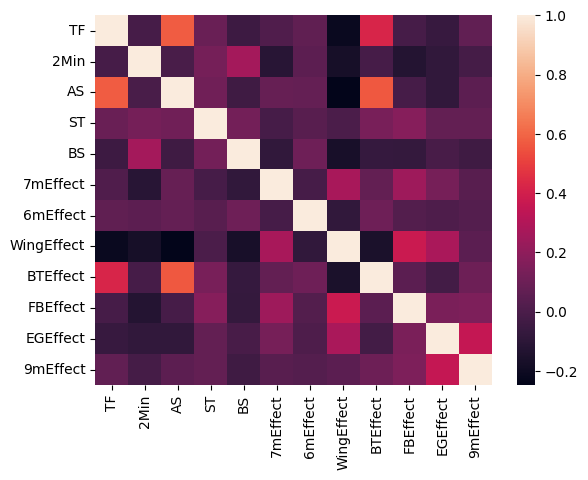

In [ ]:
sns.heatmap(mtx_corr_def, xticklabels=mtx_corr_def.columns, yticklabels=mtx_corr_def.columns, annot=False)

### Normalization

Before visualization, we have to normalize the data using PCA.

In [ ]:
from sklearn import preprocessing
from sklearn.decomposition import PCA
scaler = preprocessing.StandardScaler()
players = scaler.fit_transform(players_df)

In [ ]:
pca = PCA(n_components = 2)
X_pca = pca.fit_transform(players)

### Vizualization

In [ ]:
import plotly.express as px

fig = px.scatter(x=X_pca[:,0], y= X_pca[:,1])

fig.show()

## 2.4 Outliers detection

For detecting outliers we used two methods: DBSCAN and Boxplot (from seaborn library) + IQR method .

### DBSCAN

In [ ]:
# 3.1. Compute the similarity matrix
import sklearn.neighbors
dist = sklearn.neighbors.DistanceMetric.get_metric('euclidean')
matsim = dist.pairwise(players)


# 3.1.1 Visualization
import plotly.express as px

fig = px.imshow(matsim)
fig.show()

In [ ]:
from sklearn.neighbors import kneighbors_graph
import numpy

minPts=3

A = kneighbors_graph(players, minPts, include_self=False)
Ar = A.toarray()

seq = []
for i,s in enumerate(players):
    for j in range(len(players)):
        if Ar[i][j] != 0:
            seq.append(matsim[i][j])
            
seq.sort()

In [ ]:
fig = px.line(x=numpy.arange(0, len(seq), 1), y=seq)
fig.show()

We will check the eps in range from 2 to about 4.5 to see, which one gives us the best results.

In [ ]:
import numpy
from sklearn.cluster import DBSCAN
minPts = 3

results = []
for eps in numpy.arange(2, 4.3, 0.2):
  db = DBSCAN(eps, min_samples=minPts).fit(players)
  core_samples_mask = numpy.zeros_like(db.labels_, dtype=bool)
  core_samples_mask[db.core_sample_indices_] = True
  labels = db.labels_
  n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
  n_outliers = list(labels).count(-1)
  #print ("%6.2f, %d, %d" % (eps, n_clusters_, n_outliers))
  results.append([eps, n_clusters_, n_outliers])

#print results
from tabulate import tabulate
print(tabulate(results, headers = ("eps", "clusters", "outliers")))

With parameters of eps=4 and min_samples=3, we identified 4 outliers.

In [ ]:
from sklearn.cluster import DBSCAN

dbscan = DBSCAN(eps=4, min_samples=3)
dbscan.fit(players)

labels = dbscan.labels_
labels

In [ ]:
players_df[labels == -1]

In [ ]:
players_df.describe()

In [ ]:
import plotly.express as px

fig = px.scatter(x=X_pca[:,0], y= X_pca[:,1], color = labels)

for i in range(0,len(X_pca)):
    if labels[i] == -1:
      fig.add_annotation(x = X_pca[i,0], y = X_pca[i,1], text = players_df.index[i])
fig.show()

In [ ]:
print(pd.DataFrame(pca.components_,columns=players_df.columns,index = ['PC-1','PC-2']))


### Boxplot + IQR method

We decided to abandon this method. Our dataset contains a lot of zeros, what led to identification of many false-positive outliers.

In [ ]:
import seaborn as sns

sns.set(rc={'figure.figsize':(20,8)})
sns.boxplot(data = players_df[['7mEffect',  '6mEffect', 'WingEffect', 'BTEffect', 'FBEffect', 'EGEffect', '9mEffect']])

### Other graphs

These are the graphs created for every 'Effect' column. As we have many records in players datacard, following graphs aren't particularly useful - it is really difficult to deduce anything.

In [ ]:
import matplotlib.pyplot as plt
plt.figure(figsize = (20, 10))

players_df['7mEffect'].plot(color = 'blue')

In [ ]:
plt.figure(figsize = (20, 10))

players_df['6mEffect'].plot(color = 'blue')

In [ ]:
plt.figure(figsize = (20, 10))

players_df['WingEffect'].plot(color = 'blue')

In [ ]:
plt.figure(figsize = (20, 10))

players_df['BTEffect'].plot(color = 'blue')

In [ ]:
plt.figure(figsize = (20, 10))

players_df['FBEffect'].plot(color = 'blue')

In [ ]:
plt.figure(figsize = (20, 10))

players_df['EGEffect'].plot(color = 'blue')

In [ ]:
plt.figure(figsize = (20, 10))

players_df['9mEffect'].plot(color = 'blue')

### Deleting outliers

After analysis we decided to remove 3 outliers out of 4, as their values of features were significantly higher than the average. 

In [ ]:
players_df.drop(index=['BRAMMING Magnus', 'FURTADO Gualther', 'SEMEDO Leandro'], inplace = True)

## 2.5 Parametrization for KMeans

First, we have to normalize data using PCA.

### Normalization

In [ ]:
scaler = preprocessing.StandardScaler()
players = scaler.fit_transform(players_df)

In [ ]:
pca = PCA(n_components = 2)
X_pca = pca.fit_transform(players)

In [ ]:
import plotly.express as px

fig = px.scatter(x=X_pca[:,0], y= X_pca[:,1])

# for i in range(0,len(X_pca)):
#      fig.add_annotation(x = X_pca[i,0], y = X_pca[i,1], text = df.iloc[i,:].Name)
fig.show()

### Finding the k 

We define parameters used for performing K-means.

In [ ]:
init = 'random' # initialization method 
iterations = 10
max_iter = 300 
tol = 1e-04 
random_state = 0

Now we will use elbow method for finding the best 'k'.

In [ ]:
from sklearn import metrics
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

distortions = []
silhouettes = []

for i in range(2, 6):
    km = KMeans(n_clusters = i, init = init, n_init = iterations ,max_iter= max_iter, tol = tol,random_state = random_state)
    labels = km.fit_predict(players)
    distortions.append(km.inertia_)
    silhouettes.append(metrics.silhouette_score(players, labels))

In [ ]:
import matplotlib.pyplot as plt

x = [i for i in range(2,6)]
fig, ax1 = plt.subplots()

color = 'tab:red'
ax1.set_xlabel('k')
ax1.set_ylabel('sse', color=color)
ax1.plot(x, distortions, color=color)
ax1.tick_params(axis='y', labelcolor=color)

ax2 = ax1.twinx()  

color = 'tab:blue'
ax2.set_ylabel('silhouette', color=color) 
ax2.plot(x, silhouettes, color=color)
ax2.tick_params(axis='y', labelcolor=color)

fig.tight_layout()
plt.show()

As you can see, the 'elbow' is on k=3. It is also the place, where the 'silthouette' value is the highest.

Now we will use SilhouetteVisualizer to double check whether k=3 is the best for performing clustering.

In [ ]:
from yellowbrick.cluster import SilhouetteVisualizer

fig, ax = plt.subplots(2, 2, figsize=(15,8))
for i in [2, 3, 4, 5]:
    '''
    Create KMeans instance for different number of clusters
    '''
    km = KMeans(n_clusters=i, init='k-means++', n_init=10, max_iter=100, random_state=42)
    q, mod = divmod(i, 2)
    '''
    Create SilhouetteVisualizer instance with KMeans instance
    Fit the visualizer
    '''
    visualizer = SilhouetteVisualizer(km, colors='yellowbrick', ax=ax[q-1][mod])
    visualizer.fit(players_df)

And again, k=3 seems as the best choice.

## 2.6 K-Means

We perform K-means with 'k' set to 3.

In [ ]:
km = KMeans(n_clusters=3)

km.fit(players)

In [ ]:
fig = px.scatter(x=X_pca[:,0], y= X_pca[:,1], color = km.labels_)

fig.show()

Here is the graph showing the way K-means clustered our data.

## 2.7 Conclusions

In [ ]:
test_df = df[['Name', 'scoring']].groupby(['Name']).sum()

In [ ]:
test_df = test_df.groupby('Name').mean()

In [ ]:
test_df.drop(index=['BRAMMING Magnus', 'FURTADO Gualther', 'SEMEDO Leandro'], inplace = True)

In [ ]:
time = df.groupby('Name').sum()

In [ ]:
max(time[time['Time'] < 15].count())

In [ ]:
test_df = test_df[time['Time'] > 15]

In [ ]:
test_df[km.labels_ == 0].describe()

In [ ]:
test_df[km.labels_ == 1].describe()

In [ ]:
test_df[km.labels_ == 2].describe()

In [ ]:
players_df[km.labels_ == 0].describe()

In [ ]:
players_df[km.labels_ == 1].describe()

In [ ]:
players_df[km.labels_ == 2].describe()

The first group consists of players that were making many turnovers. However, the people in this group assisted much more than those from the other group.

The second group probably consists of players that have played on the wings because their effectiveness from wings is quite high. Also, that group has a low number of blocks. People from that group were also quite effective in fast-break goals.

The last group has the lowest mean of scoring.

# 3 Clustering for teams

In this section on discovering patterns among the teams in Handball Man
World 2021 DataSet. In order to obtain groups of teams with similar characteristics we will apply K-Means algorithm. 

In [ ]:
teams_df = df

## 3.1 Null values

For handling null values, we simply replace all nulls with zeros.

In [ ]:
teams_df.fillna(0, inplace = True)

## 3.2 Feature Selction/Feature Engineering

We decided to remove any data connected to teams or to match itself:
- 'Match No.', 'Match' and 'Phase' are connected strictly to the organization of matches
- 'Name' and 'No.' are connected to players
- 'scoring', 'prod100' - it is hard to say how these values were calculated, they don't provide any useful information
- 'Time' all the teams had on average had the same time.
- 'RC' and 'BC' only 19 red and 2 blue cards were given, moreover we do not find them very useful in our clustering.
- 'YC' yellow cards are almost meaningless in handball

In [ ]:
features_to_drop = [ 'Match', 'Name', 'No.', 'Phase', 'scoring', 'prod100', 'YC','RC', 'BC']

In [ ]:
teams_df = teams_df.drop(columns = features_to_drop)

In [ ]:
teams_df = teams_df.groupby(['Match No.', 'Team']).sum()

We group our datacard by teams' code.

In [ ]:
teams_df = teams_df.groupby('Team').mean()

We decided to create a new feature for each goal type, and substitute it for missed goals columns. The new feature will present the effectiveness of each player and will be calculated in following manner: Goals/(Goals + Missed) * Goals.

In [ ]:
teams_df['7mEffect'] =  teams_df['7mGoals'] * (teams_df['7mGoals'].div(teams_df['7mGoals'] + teams_df['7mMissed']))
teams_df['6mEffect'] =  teams_df['6mGoals'] * (teams_df['6mGoals'].div(teams_df['6mGoals'] + teams_df['6mMissed']))
teams_df['WingEffect'] = teams_df['WingGoals'] * (teams_df['WingGoals'].div(teams_df['WingGoals'] + teams_df['WingMissed']))
teams_df['BTEffect'] = teams_df['BTGoals'] * (teams_df['BTGoals'].div(teams_df['BTGoals'] + teams_df['BTMissed']))
teams_df['FBEffect'] = teams_df['FBGoals'] * (teams_df['FBGoals'].div(teams_df['FBGoals'] + teams_df['FBMissed']))
teams_df['EGEffect'] = teams_df['EGGoals'] * (teams_df['EGGoals'].div(teams_df['EGGoals'] + teams_df['EGMissed']))
teams_df['9mEffect'] = teams_df['EGGoals'] * (teams_df['9mGoals'].div(teams_df['9mGoals'] + teams_df['9mMissed']))

In [ ]:
teams_df.fillna(0, inplace = True)

As we created new features ('Effect' ones) we can delete 'Missed' and 'Goals' columns, as they are no longer useful.

In [ ]:
features_to_drop = ['7mMissed', '7mGoals', '6mMissed', '6mGoals', 'WingMissed', 'WingGoals', 'BTMissed', 'BTGoals', 'FBMissed', 'FBGoals', 'EGMissed', 'EGGoals', '9mMissed', '9mGoals' ]
teams_df = teams_df.drop(columns = features_to_drop)

In [ ]:
teams_df.head()

In [ ]:
teams_df = teams_df.drop(columns = ['Time'])

In [ ]:
teams_df.drop(index=0, inplace =True)

## 3.3 Vizualization

### Normalization

Before visualization, we have to normalize the data using PCA.

In [ ]:
from sklearn import preprocessing

scaler = preprocessing.StandardScaler()
teams = scaler.fit_transform(teams_df)

In [ ]:
from sklearn.decomposition import PCA

pca = PCA(n_components =2)
X_pca = pca.fit_transform(teams)

### Vizualization

In [ ]:
import plotly.express as px

fig = px.scatter(x=X_pca[:,0], y= X_pca[:,1])

for i in range(0,len(X_pca)):
     fig.add_annotation(x = X_pca[i,0], y = X_pca[i,1], text = teams_df.index[i])
fig.show()

## 3.4 Outliers detection

Just as before, for detecting outliers we are using two methods: DBSCAN and Boxplot (from seaborn library) + IQR method.

In [ ]:
teams_df.info()

### Box plot + IQR method

For identifying the outliers we created distinct graphs all columns. Unlike the players' dataset, these graphs were much easier to interpret (there are less teams than there are players, thus data was better distributed).

In [ ]:
import seaborn as sns
#sns.boxplot(data= teams_df[['7mEffect',  '6mEffect', 'WingEffect', 'BTEffect', 'FBEffect', 'EGEffect', '9mEffect']])
sns.set(rc={'figure.figsize':(20,8)})
sns.boxplot(data = teams_df)

As you can see on this boxplot, there are much less outliers than there was with 'players' datacard.

In [ ]:
plt.figure(figsize = (20, 10))

teams_df['TF'].plot( color = 'blue', xticks= range(32))

In [ ]:
import numpy as np
q3, q1 = np.percentile(teams_df['TF'], [75 ,25])
iqr = q3 - q1
upper_limit = q3 + 1.5 * iqr
lower_limit = q1 - 1.5 * iqr

teams_df[(teams_df['TF'] > upper_limit) | (teams_df['TF'] < lower_limit) ]

In [ ]:
plt.figure(figsize = (20, 10))

teams_df['6mEffect'].plot( color = 'blue', xticks= range(32))

In [ ]:
q3, q1 = np.percentile(teams_df['6mEffect'], [75 ,25])
iqr = q3 - q1
upper_limit = q3 + 1.5 * iqr
lower_limit = q1 - 1.5 * iqr

teams_df[(teams_df['6mEffect'] > upper_limit) | (teams_df['6mEffect'] < lower_limit) ]

In [ ]:
plt.figure(figsize = (20, 10))

teams_df['BTEffect'].plot( color = 'blue', xticks= range(32))

In [ ]:
q3, q1 = np.percentile(teams_df['BTEffect'], [75 ,25])
iqr = q3 - q1
upper_limit = q3 + 1.5 * iqr
lower_limit = q1 - 1.5 * iqr

teams_df[(teams_df['BTEffect'] > upper_limit) | (teams_df['BTEffect'] < lower_limit) ]

In [ ]:
plt.figure(figsize = (20, 10))

teams_df['7mEffect'].plot( color = 'blue', xticks= range(32))

In [ ]:
plt.figure(figsize = (20, 10))

teams_df['WingEffect'].plot( color = 'blue', xticks= range(32))

In [ ]:
plt.figure(figsize = (20, 10))

teams_df['FBEffect'].plot( color = 'blue', xticks= range(32))

In [ ]:
plt.figure(figsize = (20, 10))

teams_df['9mEffect'].plot( color = 'blue', xticks= range(32))

In [ ]:
plt.figure(figsize = (20, 10))

teams_df['2Min'].plot( color = 'blue')

In [ ]:
plt.figure(figsize = (20, 10))

teams_df['ST'].plot( color = 'blue')

We managed identify the teams, which were outliers. In total there are 7 values which are standing out from 6 teams: Uruguay, Cape Verde (2 times), Spain, DR Congo, Egypt, Tunisia.

### Detection using DBSCAN

In [ ]:
import sklearn.neighbors
dist = sklearn.neighbors.DistanceMetric.get_metric('euclidean')
matsim = dist.pairwise(teams_df)


# 3.1.1 Visualization
import plotly.express as px

fig = px.imshow(matsim)
fig.show()

In [ ]:
from sklearn.neighbors import kneighbors_graph
import numpy

minPts=3

A = kneighbors_graph(teams, minPts, include_self=False)
Ar = A.toarray()

seq = []
for i,s in enumerate(teams):
    for j in range(len(teams)):
        if Ar[i][j] != 0:
            seq.append(matsim[i][j])
            
seq.sort()

In [ ]:
fig = px.line(x=numpy.arange(0, len(seq), 1), y=seq)
fig.show()

We will check the eps in range from 4 to 6 to see, which one gives us the best results.

In [ ]:
import numpy
from sklearn.cluster import DBSCAN
minPts = 3

results = []
for eps in numpy.arange(4, 6, 0.2):
  db = DBSCAN(eps, min_samples=minPts).fit(teams_df)
  core_samples_mask = numpy.zeros_like(db.labels_, dtype=bool)
  core_samples_mask[db.core_sample_indices_] = True
  labels = db.labels_
  n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
  n_outliers = list(labels).count(-1)
  #print ("%6.2f, %d, %d" % (eps, n_clusters_, n_outliers))
  results.append([eps, n_clusters_, n_outliers])

#print results
from tabulate import tabulate
print(tabulate(results, headers = ("eps", "clusters", "outliers")))

With parameters of eps=5 and min_samples=3, we identified 3 outliers.

In [ ]:
from sklearn.cluster import DBSCAN

dbscan = DBSCAN(eps=5, min_samples=3)
dbscan.fit(teams_df)

labels = dbscan.labels_
labels

In [ ]:
teams_df[labels == -1]

In [ ]:
import plotly.express as px

fig = px.scatter(x=X_pca[:,0], y= X_pca[:,1], color = labels)

for i in range(0,len(X_pca)):
    if labels[i] == -1:
      fig.add_annotation(x = X_pca[i,0], y = X_pca[i,1], text = teams_df.index[i])
fig.show()

With the usage of DBSCAN we detected 3 outliers which were: Uruguay, Cape Verde and DR Congo.

### Deleting outliers

Taking both methods into account we decided to delete from our dataset those 3 common teams.

In [ ]:
teams_df.drop(index=['COD','URU', 'CPV'], inplace = True)

## 3.5 Parametrization

### Normalization

In [ ]:
from sklearn import preprocessing

scaler = preprocessing.StandardScaler()
teams = scaler.fit_transform(teams_df)

In [ ]:
from sklearn.decomposition import PCA

pca = PCA(n_components =2)
X_pca = pca.fit_transform(teams)

### Finding the K

In order to determine the k parameter in K means we have used both the elbow method and silhouette method. In both options, k = 3 seemed to be the best option. 

In [ ]:
from sklearn import metrics
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt
from yellowbrick.cluster import SilhouetteVisualizer
distortions = []
silhouettes = []
fig, ax = plt.subplots(2, 2, figsize=(15,8))

for i in range(2, 6):
    km = KMeans(n_clusters = i, n_init='auto', random_state = 15)
    labels = km.fit_predict(teams)
    distortions.append(km.inertia_)
    silhouettes.append(metrics.silhouette_score(teams, labels))
    q, mod = divmod(i, 2)
    km = KMeans(n_clusters = i, n_init='auto')
    visualizer = SilhouetteVisualizer(km, colors='yellowbrick', ax=ax[q-1][mod])
    visualizer.fit(teams)

In [ ]:
import matplotlib.pyplot as plt

x = [i for i in range(2,6)]
fig, ax1 = plt.subplots()

color = 'tab:red'
ax1.set_xlabel('k')
ax1.set_ylabel('sse', color=color)
ax1.plot(x, distortions, color=color)
ax1.tick_params(axis='y', labelcolor=color)

ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis

color = 'tab:blue'
ax2.set_ylabel('silhouette', color=color)  # we already handled the x-label with ax1
ax2.plot(x, silhouettes, color=color)
ax2.tick_params(axis='y', labelcolor=color)

plt.figure(figsize=(16,6))
fig.tight_layout()  # otherwise the right y-label is slightly clipped
plt.show()

## 3.6 K-Means

We perform K-means with 'k' set to 3.

In [ ]:
kmeans = KMeans(n_clusters = 3, n_init=10)

In [ ]:
kmeans.fit(teams_df)

In [ ]:
import plotly.express as px

fig = px.scatter(x=X_pca[:,0], y= X_pca[:,1], color = kmeans.labels_)

for i in range(0,len(X_pca)):
     fig.add_annotation(x = X_pca[i,0], y = X_pca[i,1], text = teams_df.index[i])
fig.show()

## 3.7 Conclusions

In [ ]:
test_df = df[['Match No.', 'Team', 'scoring']].groupby(['Match No.', 'Team']).sum()

In [ ]:
test_df = test_df.groupby('Team').mean()

In [ ]:
test_df.drop(index=[0,'COD','URU', 'CPV'], inplace = True)

In [ ]:
test_df[kmeans.labels_ == 0].describe()

In [ ]:
test_df[kmeans.labels_ == 1].describe()

In [ ]:
test_df[kmeans.labels_ == 2].describe()

In [ ]:
teams_df[kmeans.labels_ == 0].describe()

In [ ]:
teams_df[kmeans.labels_ == 1].describe()

In [ ]:
teams_df[kmeans.labels_ == 2].describe()

The first cluster consists of 5 teams: Denmark, Sweden, France, Norway and Switzerland. All teams except Switzerland (15th) were very high in the tournament (1st, 2nd, 4th, and 6th). Moreover, that group consists of teams that have high average scoring. That group has the lowest number of turnovers and 2min penalties. They have a high number of assists and are very effective in throwing from 7m and from wings.

The second cluster consists of 9 teams. They were mostly teams that ended the tournament as the top 10 and 3 teams that were the best in the president cup. Their scoring was very high and similar to the first group. That group is leading in ball recoveries and effectiveness in throws from 6m and 9m.

The last cluster consists of the rest of the teams, which were lower on the scoreboard. Their score was almost 2 times lower than in the other two groups. They have the most turnover(only a bit more than the second group) and they are not leading anywhere else.
